In [1]:
import os
os.chdir('../')
os.getcwd()

'/work'

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
from tqdm import tqdm

# drop_rateとn_addをoptunaで最適化する

データセット&ドメイン&サンプリングによってどれだけ結果が異なるか調査

同時にis_dynamically=Trueだった時のdrop_rateも取得しておく

In [4]:
import copy

import optuna
from plotly import tools
import plotly.graph_objects as go
from sklearn.metrics import mean_squared_error, accuracy_score, auc

In [5]:
from process.preprocess.get_dataset import get_dataset
from process.preprocess.get_set_options import get_options
from process.preprocess.turn_params import turn_params
from process.mainprocess.split_data import split_data
from process.mainprocess.models import DartForDomainAdaptation

In [6]:
class Args():
    def __init__(self, dataset, source, metrics, tune=False):
        self.dataset = dataset
        self.source = source
        self.metrics = metrics
        self.baseline = None
        self.tune = tune
        
CONFIG_DIR_UCI = './configs/experiments_uci.yml'
CONFIG_DIR_WEKA = './configs/experiments_weka.yml'

args_auto_mobile = Args("auto_mobile", "weka", "RMSE", tune=False)
args_autoMPG = Args("autoMPG", "weka", "RMSE", tune=False)
args_concrete = Args("concrete", "weka", "RMSE", tune=False)
args_housing = Args("housing", "weka", "RMSE", tune=False)
args_mushroom = Args("mushroom", "uci", "error rate", tune=False)

In [7]:
def preprocesses(args):
    options = get_options(args)
    # 提案手法のみ実行
    options["experiments"]["methods"] = ["DART for DA"]
    df = get_dataset(options["datasets"])
    if args.tune:
        options = turn_params(options, None, df, is_plot=False)
    return options, df

In [8]:
def return_metrics(y_true, y_pred, metrics):
    if metrics=="MSE":
        return mean_squared_error(y_true, y_pred)
    elif metrics=="RMSE":
        return mean_squared_error(y_true, y_pred)**0.5
    elif metrics=="accuracy":
        return accuracy_score(y_true, y_pred)
    elif metrics=="error rate":
        return 1 - accuracy_score(y_true, y_pred)
    elif metrics=="auc":
        return auc(y_true, y_pred)
    else:
        raise TypeError(f"{metrics} is illegal metrics.")
        

class Experiments(object):
    def __init__(self, options, df, target_domain, exp_round):
        X_train, y_train, X_train_target, y_train_target, \
        X_test, y_test, domain_col = split_data(options, df, target_domain, exp_round)
        
        self.X_train_source = X_train[domain_col!=target_domain]
        self.y_train_source = y_train[domain_col!=target_domain]
        self.X_train_target = X_train_target
        self.y_train_target = y_train_target
        self.X_test = X_test
        self.y_test = y_test
        self.domain_col = domain_col
        self.metrics = options["experiments"]["metrics"]
        self.model = DartForDomainAdaptation(options, "DART for DA")
        self.model.fit_source(self.X_train_source, self.y_train_source)
        
        
    def __call__(self, trial):
        params = {
            "drop_rate": trial.suggest_uniform("drop_rate", 0, 1),
            "n_estimators_add": trial.suggest_int("n_estimators_add", 0, 200),
            "is_best_drop": True,
            "is_drop_dynamically": False,
            "drop_mode": "latest"
        }
        return self.get_score(params)
        
        
    def get_score(self, params):
        model = copy.deepcopy(self.model)
        # update params
        model.drop_rate = params["drop_rate"]
        model.is_best_drop = params["is_best_drop"]
        model.is_drop_dynamically = params["is_drop_dynamically"]
        model.drop_mode = params["drop_mode"]
        model.n_estimators_add = params["n_estimators_add"]
        model.fit(self.X_train_target, self.y_train_target)
        pred = model.predict(self.X_test)
        
        return return_metrics(self.y_test, pred, self.metrics)
    
    def get_dynamic_drop_rate(self):
        model = copy.deepcopy(self.model)
        model.drop_rate = None
        model.is_drop_dynamically = True
        model.n_estimators_add = None
        model.fit(self.X_train_target, self.y_train_target)
        pred = model.predict(self.X_test)
        
        n_estimators = len(model.model.estimators_)
        n_dropped = sum(model.model.drop_idx)
        dynamic_drop_rate = n_dropped / n_estimators
        
        metric = return_metrics(self.y_test, pred, self.metrics)
        
        return metric, dynamic_drop_rate
    
    def get_best_drop_rate(self):
        model = copy.deepcopy(self.model)
        model.drop_rate = None
        model.is_best_drop = True
        model.n_estimators_add = None
        model.fit(self.X_train_target, self.y_train_target)
        pred = model.predict(self.X_test)
        
        n_estimators = len(model.model.estimators_)
        n_dropped = sum(model.model.drop_idx)
        best_drop_rate = n_dropped / n_estimators
        
        metric = return_metrics(self.y_test, pred, self.metrics)
        
        return metric, best_drop_rate
        
    
    
# def get_experiments_class(options, df):
#     domains = df[options['datasets']['split_feature']].unique()

In [9]:
# options_concrete, df_concrete = preprocesses(args_concrete)

In [10]:
# experiment = Experiments(options_concrete, df_concrete, 1, 0)
# study = optuna.create_study(direction="minimize")
# study.optimize(experiment, n_trials=100)

In [11]:
# optuna.visualization.plot_contour(study)

In [12]:
# optuna.visualization.plot_slice(study)

In [13]:
# fig1.select_layout_images()

In [14]:
# from plotly import tools

# fig1 = optuna.visualization.plot_contour(study)
# fig2 = optuna.visualization.plot_slice(study)

# fig = tools.make_subplots(rows=1, cols=2)
# fig.append_trace(fig1.data[0], 1, 1)
# fig.append_trace(fig1.data[1], 1, 1)
# fig.append_trace(fig1.data[0], 1, 2)
# fig.append_trace(fig1.data[1], 1, 2)
# fig

In [15]:
# len(experiment.model.model.estimators_)

In [16]:
# experiment.model.model.get_params()

In [24]:
def main(args, target_domain):
    options, df = preprocesses(args)

    fig = tools.make_subplots(rows=3, cols=3)
    for exp_num in range(9):
        experiment = Experiments(options, df, target_domain, exp_num)
        _, best_drop_rate = experiment.get_best_drop_rate()
        study = optuna.create_study(direction="minimize")
        study.optimize(experiment, n_trials=100)
        fig_contour = optuna.visualization.plot_contour(study)

        drop_line = go.Scatter(x=np.full(20,best_drop_rate), 
                               y=np.arange(0,200,10), 
                               line=dict(color="red",dash="dash"))
        fig.append_trace(fig_contour.data[0], 1+exp_num//3, 1+exp_num%3)
        fig.append_trace(drop_line, 1+exp_num//3, 1+exp_num%3)

    return fig

In [22]:
# _, fig_one = main(args_concrete, 0)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-09-10 02:34:16,525] Trial 0 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.908908115769467, 'n_estimators_add': 138}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:34:16,633] Trial 1 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.6133187473231824, 'n_estimators_add': 196}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:34:16,710] Trial 2 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.4278155337747266, 'n_estimators_add': 110}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:34:16,817] Trial 3 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.6290354477007492, 'n_estimators_add': 193}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:34:16,904] Trial 4 

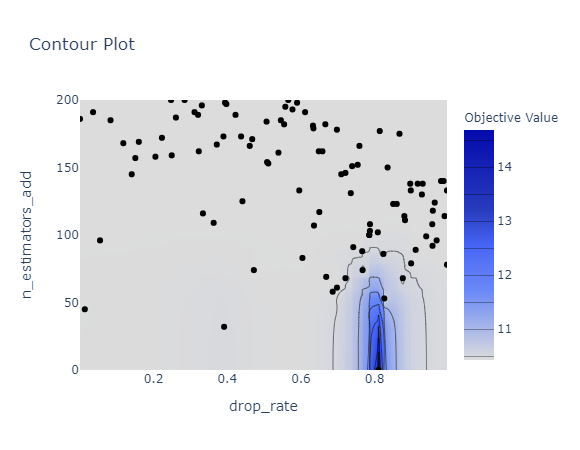

In [23]:
# fig_one

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-09-10 02:28:57,800] Trial 0 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.011609068462335226, 'n_estimators_add': 91}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:28:57,863] Trial 1 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.24127002752265714, 'n_estimators_add': 71}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:28:57,950] Trial 2 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.3815374196707132, 'n_estimators_add': 140}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:28:58,008] Trial 3 finished with value: 9.380049361705296 and parameters: {'drop_rate': 0.3088587262493231, 'n_estimators_add': 59}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:28:58,068] Trial 4

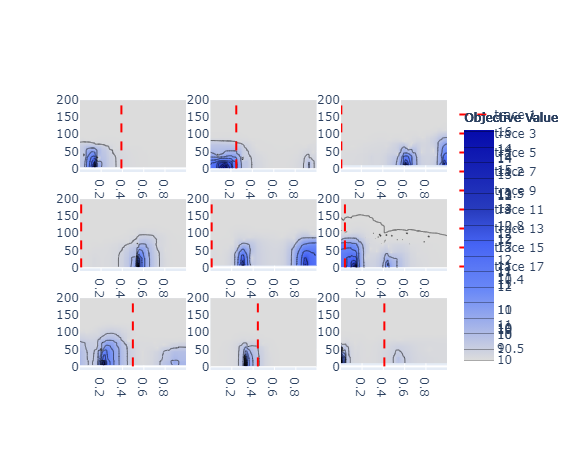

In [18]:
fig_concrete0 = main(args_concrete, 0)

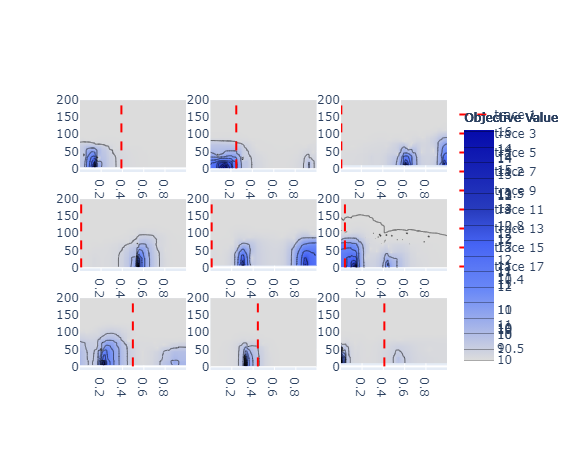

In [20]:
fig_concrete0

In [ ]:
fig_concrete0 = main(args_concrete, 0)
fig_concrete1 = main(args_concrete, 1)
fig_concrete2 = main(args_concrete, 2)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-09-10 02:37:15,896] Trial 0 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.7340292339700791, 'n_estimators_add': 150}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:37:15,955] Trial 1 finished with value: 9.380049361705296 and parameters: {'drop_rate': 0.789902801385224, 'n_estimators_add': 55}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:37:16,019] Trial 2 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.42235626640405144, 'n_estimators_add': 71}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:37:16,126] Trial 3 finished with value: 9.375316304596016 and parameters: {'drop_rate': 0.522860553934523, 'n_estimators_add': 183}. Best is trial 0 with value: 9.375316304596016.
[I 2020-09-10 02:37:16,202] Trial 4 fi

In [26]:
fig_auto_mobile0 = main(args_auto_mobile, 0)
fig_auto_mobile1 = main(args_auto_mobile, 1)
fig_auto_mobile2 = main(args_auto_mobile, 2)

[I 2020-09-10 02:41:19,573] Trial 12 finished with value: 4110.428619751418 and parameters: {'drop_rate': 0.2143839657794232, 'n_estimators_add': 3}. Best is trial 3 with value: 3953.2253772455138.
[I 2020-09-10 02:41:19,591] Trial 13 finished with value: 4110.428619751418 and parameters: {'drop_rate': 0.36334914260957835, 'n_estimators_add': 3}. Best is trial 3 with value: 3953.2253772455138.
[I 2020-09-10 02:41:19,627] Trial 14 finished with value: 4032.5803416865906 and parameters: {'drop_rate': 0.1504682415276536, 'n_estimators_add': 56}. Best is trial 3 with value: 3953.2253772455138.
[I 2020-09-10 02:41:19,651] Trial 15 finished with value: 4041.269446042238 and parameters: {'drop_rate': 0.012160238637271698, 'n_estimators_add': 21}. Best is trial 3 with value: 3953.2253772455138.
[I 2020-09-10 02:41:19,694] Trial 16 finished with value: 4032.9001798752715 and parameters: {'drop_rate': 0.34885140741422715, 'n_estimators_add': 76}. Best is trial 3 with value: 3953.2253772455138.
[

In [27]:
fig_autoMPG0 = main(args_autoMPG, 0)
fig_autoMPG1 = main(args_autoMPG, 1)
fig_autoMPG2 = main(args_autoMPG, 2)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-09-10 02:42:44,626] Trial 0 finished with value: 5.276325958365161 and parameters: {'drop_rate': 0.4200085000263337, 'n_estimators_add': 139}. Best is trial 0 with value: 5.276325958365161.
[I 2020-09-10 02:42:44,691] Trial 1 finished with value: 5.276325940267386 and parameters: {'drop_rate': 0.2352887160271534, 'n_estimators_add': 190}. Best is trial 1 with value: 5.276325940267386.
[I 2020-09-10 02:42:44,738] Trial 2 finished with value: 5.276326084122343 and parameters: {'drop_rate': 0.3079387306406979, 'n_estimators_add': 120}. Best is trial 1 with value: 5.276325940267386.
[I 2020-09-10 02:42:44,787] Trial 3 finished with value: 5.276325958365161 and parameters: {'drop_rate': 0.6000417757023242, 'n_estimators_add': 133}. Best is trial 1 with value: 5.276325940267386.
[I 2020-09-10 02:42:44,811] Trial 4

In [ ]:
fig_housing0 = main(args_housing, 0)
fig_housing1 = main(args_housing, 1)
fig_housing2 = main(args_housing, 2)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-09-10 02:44:49,361] Trial 0 finished with value: 4.937833329582208 and parameters: {'drop_rate': 0.17000839476253593, 'n_estimators_add': 79}. Best is trial 0 with value: 4.937833329582208.
[I 2020-09-10 02:44:49,415] Trial 1 finished with value: 4.937832400344494 and parameters: {'drop_rate': 0.8347116467100465, 'n_estimators_add': 126}. Best is trial 1 with value: 4.937832400344494.
[I 2020-09-10 02:44:49,485] Trial 2 finished with value: 4.937832400344494 and parameters: {'drop_rate': 0.49721518134959763, 'n_estimators_add': 178}. Best is trial 1 with value: 4.937832400344494.
[I 2020-09-10 02:44:49,554] Trial 3 finished with value: 4.937832400344494 and parameters: {'drop_rate': 0.6482145817676753, 'n_estimators_add': 174}. Best is trial 1 with value: 4.937832400344494.
[I 2020-09-10 02:44:49,602] Trial 

In [29]:
fig_mushroom0 = main(args_mushroom, "e")
fig_mushroom1 = main(args_mushroom, "t")

[I 2020-09-10 02:47:16,712] Trial 70 finished with value: 0.08135204812374675 and parameters: {'drop_rate': 0.4924023441163853, 'n_estimators_add': 141}. Best is trial 0 with value: 0.08135204812374675.
[I 2020-09-10 02:47:16,788] Trial 71 finished with value: 0.08135204812374675 and parameters: {'drop_rate': 0.4173340664564448, 'n_estimators_add': 84}. Best is trial 0 with value: 0.08135204812374675.
[I 2020-09-10 02:47:16,862] Trial 72 finished with value: 0.08135204812374675 and parameters: {'drop_rate': 0.6941051486308646, 'n_estimators_add': 81}. Best is trial 0 with value: 0.08135204812374675.
[I 2020-09-10 02:47:16,963] Trial 73 finished with value: 0.08135204812374675 and parameters: {'drop_rate': 0.6716644301525125, 'n_estimators_add': 125}. Best is trial 0 with value: 0.08135204812374675.
[I 2020-09-10 02:47:17,029] Trial 74 finished with value: 0.08135204812374675 and parameters: {'drop_rate': 0.6497259248275247, 'n_estimators_add': 69}. Best is trial 0 with value: 0.0813520

## concrete

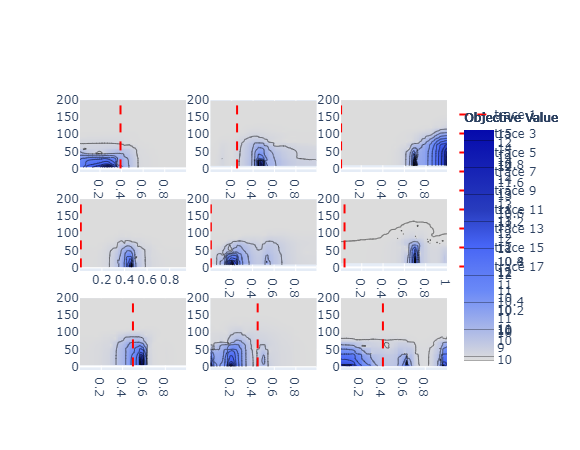

In [30]:
fig_concrete0

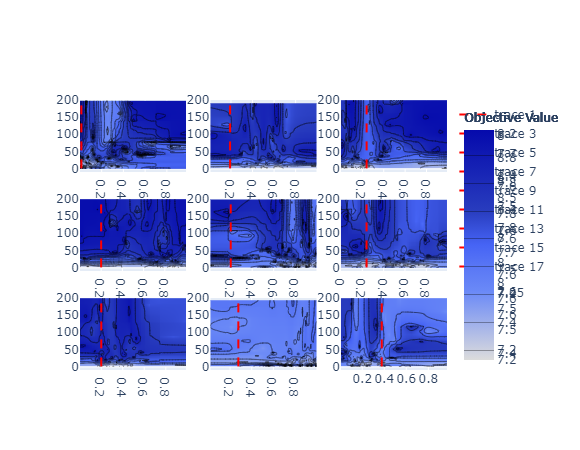

In [31]:
fig_concrete1

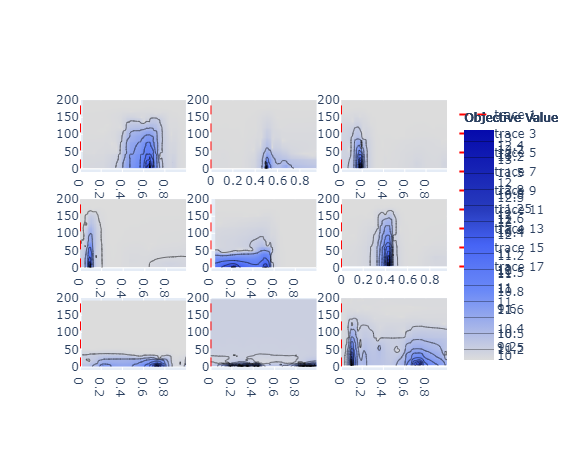

In [32]:
fig_concrete2

## auto_mobile

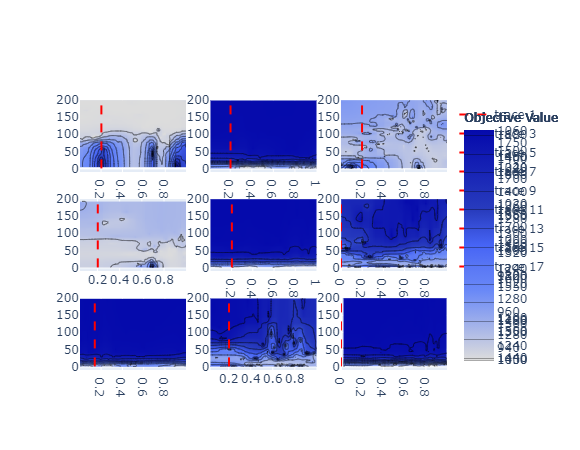

In [33]:
fig_auto_mobile0

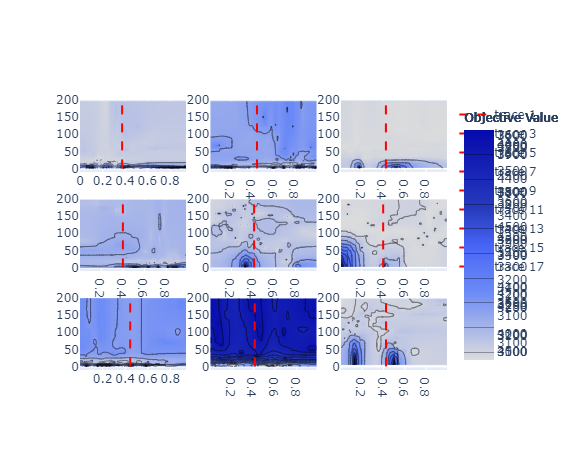

In [34]:
fig_auto_mobile1

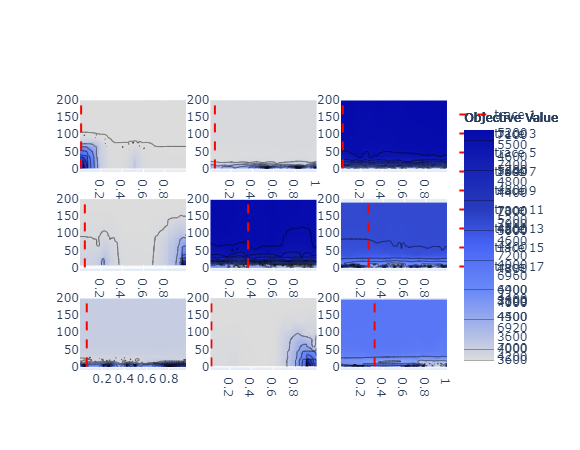

In [35]:
fig_auto_mobile2

## autoMPG

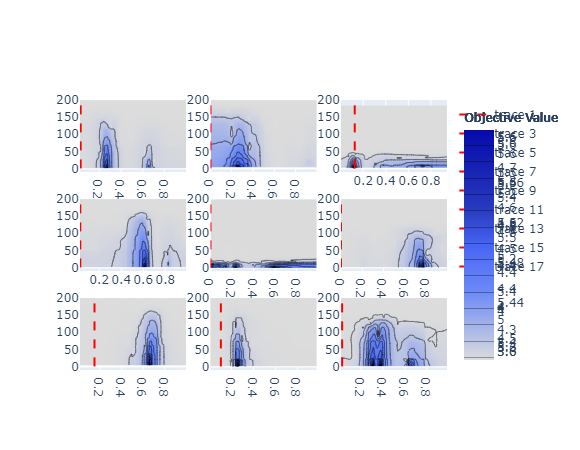

In [36]:
fig_autoMPG0

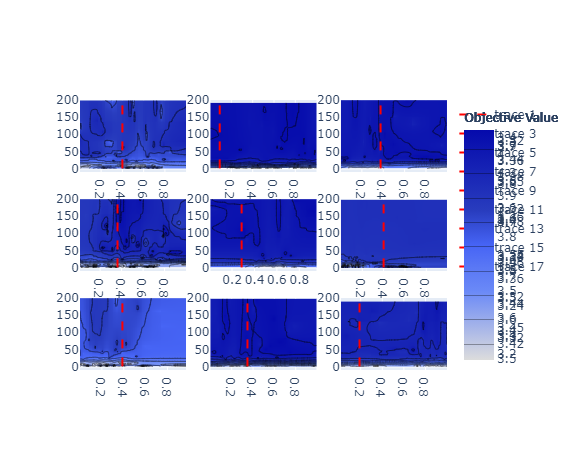

In [37]:
fig_autoMPG1

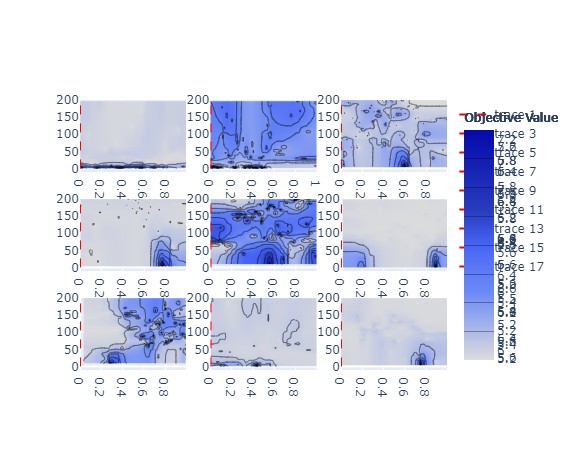

In [38]:
fig_autoMPG2

## housing

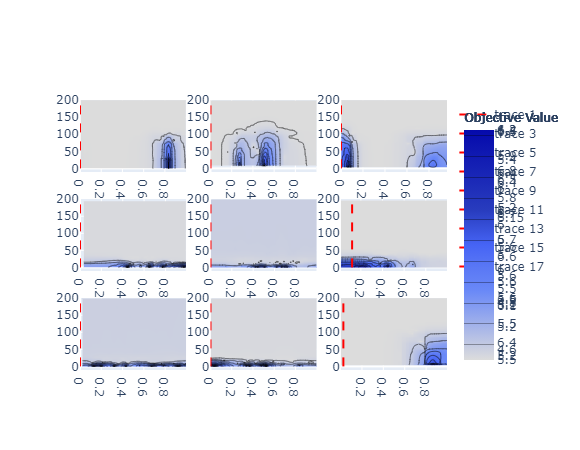

In [39]:
fig_housing0

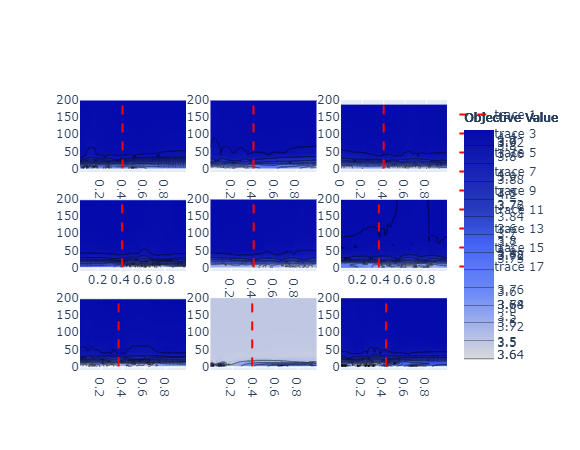

In [40]:
fig_housing1

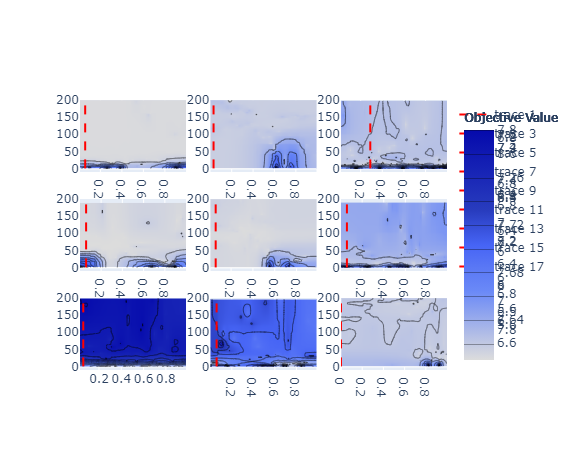

In [41]:
fig_housing2

## mushroom

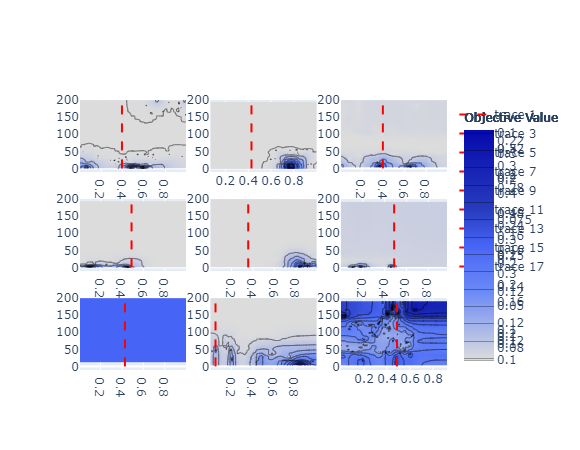

In [42]:
fig_mushroom0

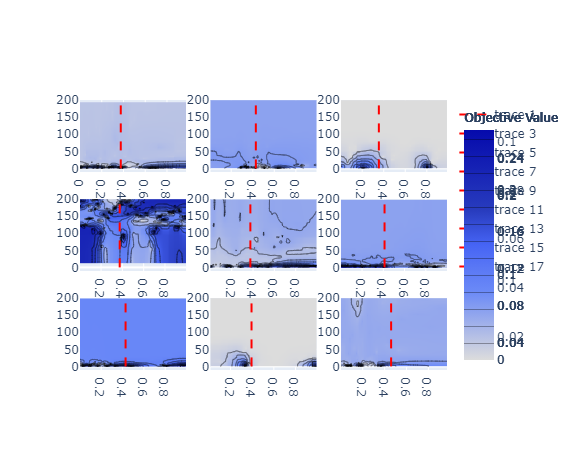

In [43]:
fig_mushroom1